# Cell size and genomic context - KEGG pathways

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib.legend import Legend
import seaborn as sns
import re

In [2]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split

In [3]:
from scipy.stats import spearmanr, kstest, norm
import statsmodels.api as sm
import requests
import time

In [4]:
plt.rcParams.update({
    'figure.autolayout': True,
    'savefig.bbox': 'tight',
    'svg.fonttype': 'none',
    'font.sans-serif': 'Arial',
    'font.size': 11,
    'boxplot.medianprops.linewidth': 2,
    'boxplot.flierprops.markeredgecolor': 'none',
    'boxplot.flierprops.markersize': 5})

Load data

In [5]:
df = pd.read_table('../phylogeny/place/fine_all.tsv', index_col = 0)
df['log_svratio'] = np.log10(df['volume'] / df['surface'])
df['log_volume'] = np.log10(df['volume'])
df.shape

(5380, 24)

### Get species with available genomic information

In [6]:
df1 = df[df['node'].str.contains('G')].copy()

**Because of our methodology (phylogenetic placement) some species have been assigned to the same genome, so we need to get rid of the duplicates and select only those species whose taxonomic name matches the genome name**

In [7]:
dft = pd.read_table('../phylogeny/tax2tree/filled_ranks.tsv', index_col = 0)

In [8]:
df1['is_species'] = df1['node'].apply(lambda x: dft.loc[x]['species'] if x in dft.index else np.nan)

In [9]:
df1 = df1[df1['species'] == df1['is_species']]

Sort genomes by size

In [10]:
df1.sort_values(by = ['log_svratio'], inplace = True)

In [11]:
genomes = df1['node'].to_list()

In [12]:
len(genomes)

1363

## Load KEGG genome annotations

In [14]:
def loadKEGGv1(fIn):
    annot = {}
    
    with open(fIn, 'r') as f:
        for line in f:
            orf = line.strip().split('\t')[0]
            kos = line.strip().split('\t')[1:]
            annot[orf] = [ko for ko in kos]
            
    return annot

In [15]:
def loadKEGGv2(fIn):
    annot = {}
    
    with open(fIn, 'r') as f:
        for line in f:
            genome = line.strip().split('\t')[0].split('_')[0]
            kos = line.strip().split('\t')[1:]
            
            if genome not in annot.keys():
                annot[genome] = [ko for ko in kos]
            else:
                for ko in kos:
                    annot[genome].append(ko)
                
    return annot

In [16]:
def loadDescription(fIn):
    '''
    Function that loads the description of an annotation system e.g. Uniref, KEGG, GO
    Inputs:
        fIn: file containing the descriptions
    Outputs:
        description: dictionary with functional units (str) as keys and their description (str) as values
    '''
    
    # Structure
    description = {}
    
    # Iterate over file
    with open(fIn, 'r') as f:
        for line in f:
            funit = line.strip().split('\t')[0]
            desc = line.strip().split('\t')[1]
            description[funit] = desc
            
    return description

In [17]:
def loadMapping(fIn):
    '''
    Function that loas a mapping file between two annotation systems
    Inputs:
        fIn: file containing the mapping
    Outputs:
        mapping: dictionary with uniref (str) as keys and ko (str) as values
    '''
    
    # Structure
    mapping = {}
    
    # Iterate over file
    with open(fIn, 'r') as f:
        for line in f:
            uni = line.strip().split('\t')[0]
            ko = line.strip().split('\t')[1]
            mapping[uni] = ko
    
    return mapping

In [18]:
def loadMapping3(fIn):
    '''
    Function that loas a mapping file between two annotation systems
    Inputs:
        fIn: file containing the mapping
    Outputs:
        mapping: dictionary with uniref (str) as keys and kos (str) as list
    '''
    
    # Structure
    mapping = {}
    
    # Iterate over file
    with open(fIn, 'r') as f:
        for line in f:
            ko = line.strip().split('\t')[0]
            rclass = line.strip().split('\t')[2]
            mapping[ko] = rclass
    
    return mapping

In [19]:
def loadMapping2(fIn):
    '''
    Function that loas a mapping file between two annotation systems
    Inputs:
        fIn: file containing the mapping
    Outputs:
        mapping: dictionary with uniref (str) as keys and kos (str) as list
    '''
    
    # Structure
    mapping = {}
    
    # Iterate over file
    with open(fIn, 'r') as f:
        for line in f:
            uni = line.strip().split('\t')[0]
            ko = line.strip().split('\t')[1:]
            mapping[uni] = ko
    
    return mapping

In [20]:
def loadProtSeqs(fIn):
    '''
    Function that loads the protein sequences from a FASTA file
    Inputs:
        fIn: file containing the protein sequences
    Outputs:
        protein_sequences: dictionary containing the orfs (keys) and protein sequences (values)
    '''
    protein_sequences = {}
    
    with open(fIn, 'r') as f:
        for line in f:
            if line[0] == '>':
                orf = line.strip()[1:]
            else:
                protein_sequences[orf] = line.strip()

    return protein_sequences

In [21]:
%%time
orf_to_kegg_orfs = loadKEGGv1('function/kegg/orf-to-ko_genome_genomic_information.map')
orf_to_kegg = loadKEGGv2('function/kegg/orf-to-ko_genome_genomic_information.map')

CPU times: user 12.7 s, sys: 871 ms, total: 13.6 s
Wall time: 13.6 s


Protein sequence file available from the Web of Life project

In [22]:
%%time
protein_sequences = loadProtSeqs('function/kegg/all_genomes_genomic_information.faa')

CPU times: user 8.44 s, sys: 2.68 s, total: 11.1 s
Wall time: 11.1 s


In [23]:
%%time
description_pathways = loadDescription('function/kegg/pathways_curated.txt')

CPU times: user 1.03 ms, sys: 167 µs, total: 1.2 ms
Wall time: 856 µs


In [24]:
%%time
map_ko_pathways2 = loadMapping2('function/kegg/ko-to-pathway.map')

CPU times: user 58.7 ms, sys: 4.43 ms, total: 63.1 ms
Wall time: 62.3 ms


Get genomes that have been annotated

In [25]:
genomes2 = list(set(genomes).intersection(set(list(orf_to_kegg.keys()))))

In [26]:
df2 = df1[df1['node'].isin(genomes2)].copy()
df2.sort_values(['log_svratio'], inplace = True)
genomes2 = df2['node'].to_list()

In [27]:
len(genomes2)

1361

## KEGG pathways 

Load genes associated to pathways

In [28]:
genes_pathways = {}
with open('function/kegg/pathways_genes.txt', 'r') as f:
    for line in f:
        ptw, gene = line.strip().split(',')[0], line.strip().split(',')[1]
        if ptw not in genes_pathways.keys():
            genes_pathways[ptw] = [gene]
        else:
            genes_pathways[ptw].append(gene)

In [29]:
len(genes_pathways)

263

## Associations of KEGG pathways with cell size

Count the number of **different** genes in a pathway

In [32]:
def find_hits_different_genes(set_genes, normalize = False):
    '''Function that finds the number of different genes in a pathway (set_genes)
    '''
    hits = []
    for genome in genomes2:
        counts = set()
        for ko in orf_to_kegg[genome]:
            annotated_orfs = len(orf_to_kegg[genome])
            if ko in set_genes:
                counts.add(ko)
        # Store the number of **different** genes in the pathway
        hits.append(len(counts))
        
    if normalize:
        hits_ = np.array(hits) / len(set_genes)
    else:
        hits_ = np.array(hits)

    return hits_

In [33]:
def find_hits_all_genes(set_genes, normalize = False):
    '''Function that finds the number of genes in a pathway (set_genes)'''
    hits = []
    for genome in genomes2:
        counts = []
        for ko in orf_to_kegg[genome]:
            annotated_orfs = len(orf_to_kegg[genome])
            if ko in set_genes:
                counts.append(ko)
        # Store all the genes in the pathway
        hits.append(len(counts))
        
    hits = np.array(hits)
    if normalize:
        hits_ = (hits - hits.min()) / (hits.max() - hits.min())
    else:
        hits_ = hits

    return hits_

In [34]:
def find_hits_all_base_pairs(set_genes, orfs, kos_all_orfs, orfs_genome, normalize = False):
    '''Function that finds the total base pair length of protein sequences (amino acids * 3)
    in a pathway (set_genes)'''
    hits = []
    for genome in genomes2:
        counts = []
        # Get all the ORFS of genome
        for orf, kos in zip(orfs[(orfs_genome == genome).nonzero()], kos_all_orfs[(orfs_genome == genome).nonzero()]):
            for ko in kos:
                if ko in set_genes:
                    # Extract protein sequences associated with orf
                    if orf in protein_sequences.keys():
                        prot_seq = protein_sequences[orf]
                    else:
                        print(f'ORF {orf} annotated as {ko} does not have a protein sequence!')
                    # To get the base pairs multiply by 3 (since you have amino acids) and sum three
                    # to account for the bp of the stop codon
                    bp_seq = (len(prot_seq) * 3) + 3
                    counts.append(bp_seq)
                    
        # Store total bp of genes (i.e. sum) involved in pathway
        hits.append(np.sum(np.array(counts)))
    
    hits = np.array(hits)
    if normalize:
        hits_ = (hits - hits.min()) / (hits.max() - hits.min())
    else:
        hits_ = hits

    return hits_

In [35]:
orfs, kos_all_orfs = np.array(list(orf_to_kegg_orfs.keys())), np.array(list(orf_to_kegg_orfs.values()), dtype = object)
orfs_genome = np.array([orf.split('_')[0] for orf in orfs])

# Multiple pathways

In [55]:
size = 'log_svratio'

In [56]:
mu = np.mean(df2[size])
std = np.std(df2[size])

Number of different proteins


KEGG pathway: ko01110, Biosynthesis of secondary metabolites
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.068
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     98.84
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.58e-22
Time:                        13:10:03   Log-Likelihood:                -7400.9
No. Observations:                1361   AIC:                         1.481e+04
Df Residuals:                    1359   BIC:                         1.482e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------


KEGG pathway: ko01212, Fatty acid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.214
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0732
Time:                        13:11:32   Log-Likelihood:                -4388.4
No. Observations:                1361   AIC:                             8781.
Df Residuals:                    1359   BIC:                             8791.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko01240, Biosynthesis of cofactors
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.091
Model:                            OLS   Adj. R-squared:                  0.090
Method:                 Least Squares   F-statistic:                     135.7
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           5.84e-30
Time:                        13:12:21   Log-Likelihood:                -6381.5
No. Observations:                1361   AIC:                         1.277e+04
Df Residuals:                    1359   BIC:                         1.278e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00030, Pentose phosphate pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.053
Model:                            OLS   Adj. R-squared:                  0.052
Method:                 Least Squares   F-statistic:                     76.10
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.75e-18
Time:                        13:12:48   Log-Likelihood:                -4071.9
No. Observations:                1361   AIC:                             8148.
Df Residuals:                    1359   BIC:                             8158.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00053, Ascorbate and aldarate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     4.022
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0451
Time:                        13:13:08   Log-Likelihood:                -3601.5
No. Observations:                1361   AIC:                             7207.
Df Residuals:                    1359   BIC:                             7218.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

<timed exec>:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



KEGG pathway: ko00630, Glyoxylate and dicarboxylate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                  0.018
Method:                 Least Squares   F-statistic:                     25.36
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           5.40e-07
Time:                        13:13:36   Log-Likelihood:                -5033.6
No. Observations:                1361   AIC:                         1.007e+04
Df Residuals:                    1359   BIC:                         1.008e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------


KEGG pathway: ko00562, Inositol phosphate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.534
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0603
Time:                        13:13:55   Log-Likelihood:                -3423.5
No. Observations:                1361   AIC:                             6851.
Df Residuals:                    1359   BIC:                             6861.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------


KEGG pathway: ko00710, Carbon fixation in photosynthetic organisms
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.076
Model:                            OLS   Adj. R-squared:                  0.075
Method:                 Least Squares   F-statistic:                     111.4
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           4.46e-25
Time:                        13:14:16   Log-Likelihood:                -3191.6
No. Observations:                1361   AIC:                             6387.
Df Residuals:                    1359   BIC:                             6398.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------


KEGG pathway: ko00920, Sulfur metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.023
Model:                            OLS   Adj. R-squared:                  0.022
Method:                 Least Squares   F-statistic:                     31.51
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.40e-08
Time:                        13:14:44   Log-Likelihood:                -4662.7
No. Observations:                1361   AIC:                             9329.
Df Residuals:                    1359   BIC:                             9340.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------


KEGG pathway: ko00073, Cutin, suberine and wax biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.3166
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.574
Time:                        13:14:53   Log-Likelihood:                 473.18
No. Observations:                1361   AIC:                            -942.4
Df Residuals:                    1359   BIC:                            -931.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00140, Steroid hormone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.558
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.212
Time:                        13:15:02   Log-Likelihood:                -961.32
No. Observations:                1361   AIC:                             1927.
Df Residuals:                    1359   BIC:                             1937.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00600, Sphingolipid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.03980
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.842
Time:                        13:15:19   Log-Likelihood:                -2749.1
No. Observations:                1361   AIC:                             5502.
Df Residuals:                    1359   BIC:                             5513.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko01040, Biosynthesis of unsaturated fatty acids
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.410
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.121
Time:                        13:15:28   Log-Likelihood:                -2572.7
No. Observations:                1361   AIC:                             5149.
Df Residuals:                    1359   BIC:                             5160.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------


KEGG pathway: ko00260, Glycine, serine and threonine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.013
Model:                            OLS   Adj. R-squared:                  0.013
Method:                 Least Squares   F-statistic:                     18.36
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.96e-05
Time:                        13:15:57   Log-Likelihood:                -4840.0
No. Observations:                1361   AIC:                             9684.
Df Residuals:                    1359   BIC:                             9694.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko00300, Lysine biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.065
Model:                            OLS   Adj. R-squared:                  0.064
Method:                 Least Squares   F-statistic:                     93.76
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.73e-21
Time:                        13:16:12   Log-Likelihood:                -3328.2
No. Observations:                1361   AIC:                             6660.
Df Residuals:                    1359   BIC:                             6671.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00340, Histidine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.035
Model:                            OLS   Adj. R-squared:                  0.035
Method:                 Least Squares   F-statistic:                     50.02
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.43e-12
Time:                        13:16:31   Log-Likelihood:                -3881.5
No. Observations:                1361   AIC:                             7767.
Df Residuals:                    1359   BIC:                             7778.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00400, Phenylalanine, tyrosine and tryptophan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.057
Model:                            OLS   Adj. R-squared:                  0.056
Method:                 Least Squares   F-statistic:                     81.65
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           5.43e-19
Time:                        13:16:49   Log-Likelihood:                -4115.8
No. Observations:                1361   AIC:                             8236.
Df Residuals:                    1359   BIC:                             8246.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------


KEGG pathway: ko00450, Selenocompound metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.052
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0248
Time:                        13:17:00   Log-Likelihood:                -3209.4
No. Observations:                1361   AIC:                             6423.
Df Residuals:                    1359   BIC:                             6433.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00510, N-Glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     7.191
Date:                Wed, 01 Nov 2023   Prob (F-statistic):            0.00742
Time:                        13:17:12   Log-Likelihood:                -1342.6
No. Observations:                1361   AIC:                             2689.
Df Residuals:                    1359   BIC:                             2700.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00512, Mucin type O-glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:17:17   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------


KEGG pathway: ko00534, Glycosaminoglycan biosynthesis - heparan sulfate / heparin
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.04196
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.838
Time:                        13:17:25   Log-Likelihood:                 1144.0
No. Observations:                1361   AIC:                            -2284.
Df Residuals:                    1359   BIC:                            -2274.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00533, Glycosaminoglycan biosynthesis - keratan sulfate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:17:26   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00601, Glycosphingolipid biosynthesis - lacto and neolacto series
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:17:30   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------


KEGG pathway: ko00540, Lipopolysaccharide biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.3631
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.547
Time:                        13:17:37   Log-Likelihood:                -4801.4
No. Observations:                1361   AIC:                             9607.
Df Residuals:                    1359   BIC:                             9617.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko00552, Teichoic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.050
Model:                            OLS   Adj. R-squared:                  0.049
Method:                 Least Squares   F-statistic:                     71.28
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.85e-17
Time:                        13:17:50   Log-Likelihood:                -3271.3
No. Observations:                1361   AIC:                             6547.
Df Residuals:                    1359   BIC:                             6557.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00730, Thiamine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.060
Method:                 Least Squares   F-statistic:                     87.64
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.15e-20
Time:                        13:17:58   Log-Likelihood:                -3403.1
No. Observations:                1361   AIC:                             6810.
Df Residuals:                    1359   BIC:                             6821.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00770, Pantothenate and CoA biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.036
Model:                            OLS   Adj. R-squared:                  0.035
Method:                 Least Squares   F-statistic:                     50.22
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.20e-12
Time:                        13:18:09   Log-Likelihood:                -3720.8
No. Observations:                1361   AIC:                             7446.
Df Residuals:                    1359   BIC:                             7456.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------


KEGG pathway: ko00670, One carbon pool by folate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     20.57
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.25e-06
Time:                        13:18:19   Log-Likelihood:                -3209.5
No. Observations:                1361   AIC:                             6423.
Df Residuals:                    1359   BIC:                             6433.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00900, Terpenoid backbone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.086
Model:                            OLS   Adj. R-squared:                  0.085
Method:                 Least Squares   F-statistic:                     127.1
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.02e-28
Time:                        13:18:34   Log-Likelihood:                -3125.8
No. Observations:                1361   AIC:                             6256.
Df Residuals:                    1359   BIC:                             6266.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00902, Monoterpenoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:18:36   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00904, Diterpenoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:18:44   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00905, Brassinosteroid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:18:48   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00907, Pinene, camphor and geraniol degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.869
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0494
Time:                        13:18:53   Log-Likelihood:                -3043.5
No. Observations:                1361   AIC:                             6091.
Df Residuals:                    1359   BIC:                             6102.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko01059, Biosynthesis of enediyne antibiotics
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.4481
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.503
Time:                        13:19:09   Log-Likelihood:                -1998.8
No. Observations:                1361   AIC:                             4002.
Df Residuals:                    1359   BIC:                             4012.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00523, Polyketide sugar unit biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.011
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     14.80
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000125
Time:                        13:19:18   Log-Likelihood:                -2684.8
No. Observations:                1361   AIC:                             5374.
Df Residuals:                    1359   BIC:                             5384.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------


KEGG pathway: ko00940, Phenylpropanoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.029
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     40.50
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.68e-10
Time:                        13:19:27   Log-Likelihood:                -1719.5
No. Observations:                1361   AIC:                             3443.
Df Residuals:                    1359   BIC:                             3453.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00942, Anthocyanin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:19:34   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00943, Isoflavonoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:19:35   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00403, Indole diterpene alkaloid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:19:40   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------


KEGG pathway: ko00232, Caffeine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1884
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.664
Time:                        13:19:48   Log-Likelihood:                -16.817
No. Observations:                1361   AIC:                             37.63
Df Residuals:                    1359   BIC:                             48.07
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00402, Benzoxazinoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:19:51   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00331, Clavulanic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.06639
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.797
Time:                        13:19:56   Log-Likelihood:                 1484.6
No. Observations:                1361   AIC:                            -2965.
Df Residuals:                    1359   BIC:                            -2955.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00401, Novobiocin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.038
Model:                            OLS   Adj. R-squared:                  0.038
Method:                 Least Squares   F-statistic:                     54.08
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.32e-13
Time:                        13:20:05   Log-Likelihood:                -2056.3
No. Observations:                1361   AIC:                             4117.
Df Residuals:                    1359   BIC:                             4127.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00254, Aflatoxin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:20:12   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko00362, Benzoate degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.4452
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.505
Time:                        13:20:28   Log-Likelihood:                -4671.9
No. Observations:                1361   AIC:                             9348.
Df Residuals:                    1359   BIC:                             9358.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00361, Chlorocyclohexane and chlorobenzene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.191
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0743
Time:                        13:20:39   Log-Likelihood:                -2930.4
No. Observations:                1361   AIC:                             5865.
Df Residuals:                    1359   BIC:                             5875.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------


KEGG pathway: ko00642, Ethylbenzene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.7406
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.390
Time:                        13:20:47   Log-Likelihood:                -1320.9
No. Observations:                1361   AIC:                             2646.
Df Residuals:                    1359   BIC:                             2656.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------


KEGG pathway: ko00363, Bisphenol degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1132
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.737
Time:                        13:20:53   Log-Likelihood:                -197.88
No. Observations:                1361   AIC:                             399.8
Df Residuals:                    1359   BIC:                             410.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko00365, Furfural degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.262
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.262
Time:                        13:21:01   Log-Likelihood:                -1536.7
No. Observations:                1361   AIC:                             3077.
Df Residuals:                    1359   BIC:                             3088.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00983, Drug metabolism - other enzymes
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     6.380
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0117
Time:                        13:21:07   Log-Likelihood:                -3038.9
No. Observations:                1361   AIC:                             6082.
Df Residuals:                    1359   BIC:                             6092.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko03010, Ribosome
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.140
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.144
Time:                        13:21:25   Log-Likelihood:                -3247.0
No. Observations:                1361   AIC:                             6498.
Df Residuals:                    1359   BIC:                             6508.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
cons


KEGG pathway: ko03008, Ribosome biogenesis in eukaryotes
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.532
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0188
Time:                        13:21:41   Log-Likelihood:                -3129.8
No. Observations:                1361   AIC:                             6264.
Df Residuals:                    1359   BIC:                             6274.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04130, SNARE interactions in vesicular transport
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:21:53   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------


KEGG pathway: ko03018, RNA degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.7147
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.398
Time:                        13:22:08   Log-Likelihood:                -3337.2
No. Observations:                1361   AIC:                             6678.
Df Residuals:                    1359   BIC:                             6689.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------


KEGG pathway: ko03430, Mismatch repair
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     9.915
Date:                Wed, 01 Nov 2023   Prob (F-statistic):            0.00167
Time:                        13:22:21   Log-Likelihood:                -3417.4
No. Observations:                1361   AIC:                             6839.
Df Residuals:                    1359   BIC:                             6849.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03230, Viral genome structure
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:34   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03240, Viral replication
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:40   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03260, Virion - Human immunodeficiency virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:46   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03262, Virion - Coronavirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:47   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03261, Virion - Influenza A virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:49   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03263, Virion - Enterovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:50   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03264, Virion - Flavivirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:51   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03265, Virion - Lyssavirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:52   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03266, Virion - Herpesvirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:54   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03268, Virion - Orthopoxvirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:57   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03267, Virion - Adenovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:22:58   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko02020, Two-component system
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.029
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     40.85
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.25e-10
Time:                        13:23:57   Log-Likelihood:                -6422.3
No. Observations:                1361   AIC:                         1.285e+04
Df Residuals:                    1359   BIC:                         1.286e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04010, MAPK signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:24:08   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04012, ErbB signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:24:24   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04015, Rap1 signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:24:39   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04341, Hedgehog signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1311
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.717
Time:                        13:24:51   Log-Likelihood:                 317.05
No. Observations:                1361   AIC:                            -630.1
Df Residuals:                    1359   BIC:                            -619.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04350, TGF-beta signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:24:56   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04390, Hippo signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:25:01   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04391, Hippo signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:25:04   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04392, Hippo signaling pathway - multiple species
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:25:06   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04630, JAK-STAT signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:25:19   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko04068, FoxO signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1196
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.730
Time:                        13:25:37   Log-Likelihood:                -1721.4
No. Observations:                1361   AIC:                             3447.
Df Residuals:                    1359   BIC:                             3457.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04071, Sphingolipid signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     1.837
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.176
Time:                        13:25:59   Log-Likelihood:                -889.73
No. Observations:                1361   AIC:                             1783.
Df Residuals:                    1359   BIC:                             1794.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------


KEGG pathway: ko04152, AMPK signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.516
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.113
Time:                        13:26:30   Log-Likelihood:                -1843.4
No. Observations:                1361   AIC:                             3691.
Df Residuals:                    1359   BIC:                             3701.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04060, Cytokine-cytokine receptor interaction
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:27:07   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04061, Viral protein interaction with cytokine and cytokine receptor
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:27:13   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04514, Cell adhesion molecules
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:27:21   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko02026, Biofilm formation - Escherichia coli
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.009
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     13.01
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000321
Time:                        13:27:47   Log-Likelihood:                -4362.8
No. Observations:                1361   AIC:                             8730.
Df Residuals:                    1359   BIC:                             8740.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko04110, Cell cycle
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.471
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0195
Time:                        13:28:00   Log-Likelihood:                 49.313
No. Observations:                1361   AIC:                            -94.63
Df Residuals:                    1359   BIC:                            -84.19
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
co

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04810, Regulation of actin cytoskeleton
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:28:08   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

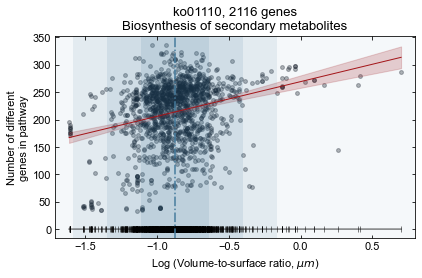

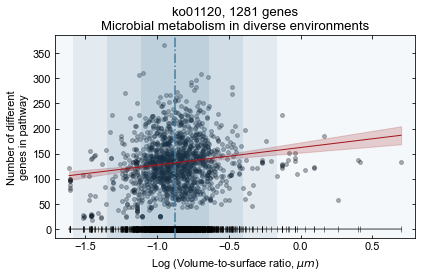

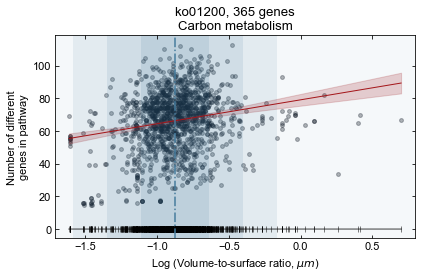

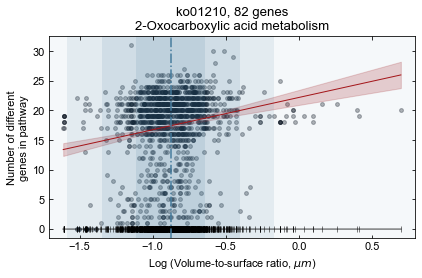

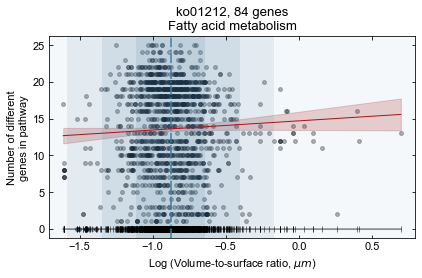

...

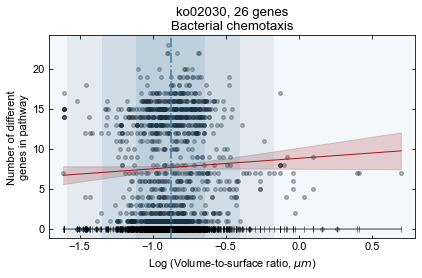

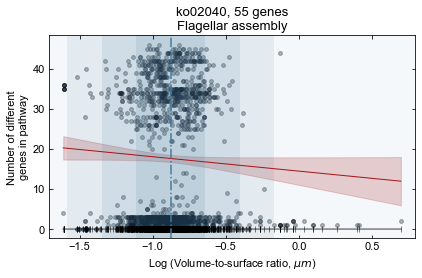

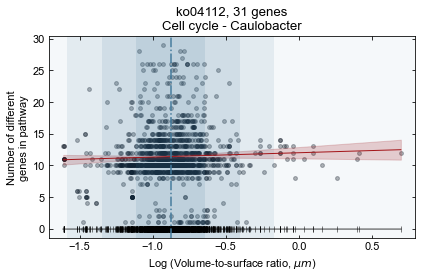

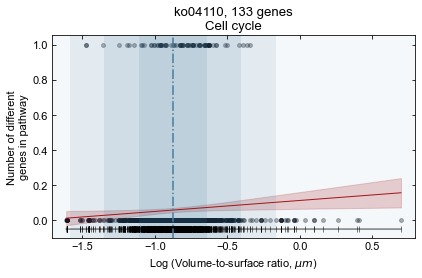

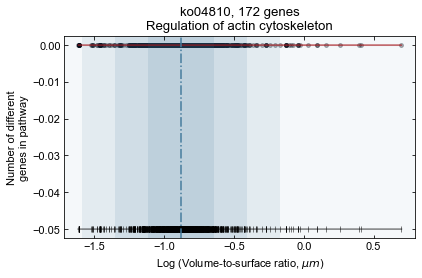

CPU times: user 39min 25s, sys: 1min 13s, total: 40min 38s
Wall time: 20min 30s


In [57]:
%%time
tmp = []
for pathway, genes in genes_pathways.items():
    
    # Get hits
    hits_different = find_hits_different_genes(genes)
    # Figure
    plt.figure()

    # Data
    x, y = df2[size], hits_different
    x_reg = sm.add_constant(x)

    # Linear regression
    reg = sm.OLS(y, x_reg).fit()
    intercept, slope = reg.params
    x_reg_ = np.linspace(x.min(), x.max(), x.shape[0])
    y_pred = reg.get_prediction(sm.add_constant(x_reg_))
    residuals = y - reg.predict()
    parameters = norm.fit(residuals)
    KS = kstest(residuals, 'norm', parameters)

    # Spearman correlation
    pr = spearmanr(x, y)

    # Plot
    plt.scatter(x, y, alpha = 0.3, color = '#000814', s = 15)
    plt.plot(x, np.full_like(x, -0.05), color = 'black', marker = '|',
                         alpha = 0.5)

    plt.plot(x, (x * slope + intercept), c = '#a4161a', lw = 1)
    plt.fill_between(x_reg_, *zip(*y_pred.conf_int()), color = '#a4161a', alpha = 0.2)


    # Mean and standard deviations
    plt.axvline(x = mu, color = '#457b9d', linestyle = 'dashdot', alpha = 1.0)
    for i in range(0, 4):
        low_r = mu + std * i
        up_r = mu + std * (i + 1)
        low_l = mu - std * i
        up_l = mu - std * (i + 1)
        if i == 3:
            up_r = x.max() + 0.1
            up_l = x.min() - 0.1
        plt.axvspan(low_r, up_r, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)
        plt.axvspan(low_l, up_l, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)

    plt.ylabel('Number of different\ngenes in pathway')
    plt.xlabel(f'Log (Volume-to-surface ratio, $\\mu m$)')
    plt.title(f'{pathway}, {len(genes)} genes\n{description_pathways[pathway]}')


    plt.xlim(x.min() - 0.1, x.max() + 0.1)
    plt.tick_params(top = True, right = True, direction = 'in', which = 'both')

    print(f'\nKEGG pathway: {pathway}, {description_pathways[pathway]}')
    print(f'OLS summary: {reg.summary()}')
    print(f'Nomality residuals: {KS}')
    print(f'Spearman rank correlation: {pr}')
    
    # Save to dataframe
    df2[f'hits_different_{pathway}'] = hits_different
    
    # Add values to table
    tmp.append([description_pathways[pathway], pathway, len(genes),
            reg.params[0], reg.bse[0], reg.pvalues[0],
            reg.params[1], reg.bse[1], reg.pvalues[1],
      reg.rsquared_adj, reg.aic])

# Save data frame
df_reg_different = pd.DataFrame(tmp, columns = ['Pathway name', 'ko', 'Number of genes',
                                          'Alpha', 'Standard error', 'P-value alpha',
                                         'Beta', 'Standard error', 'P-value beta',
                                         'R squared adj', 'AIC'])
df_reg_different.set_index('Pathway name', inplace = True)
df_reg_different.to_csv('kegg_lregress/different_genes.csv')
    
plt.show()

Number of total proteins


KEGG pathway: ko01110, Biosynthesis of secondary metabolites
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.058
Model:                            OLS   Adj. R-squared:                  0.057
Method:                 Least Squares   F-statistic:                     83.36
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.40e-19
Time:                        13:30:18   Log-Likelihood:                -7913.4
No. Observations:                1361   AIC:                         1.583e+04
Df Residuals:                    1359   BIC:                         1.584e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------


KEGG pathway: ko01212, Fatty acid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.418
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.234
Time:                        13:31:34   Log-Likelihood:                -5888.3
No. Observations:                1361   AIC:                         1.178e+04
Df Residuals:                    1359   BIC:                         1.179e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko01240, Biosynthesis of cofactors
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.095
Model:                            OLS   Adj. R-squared:                  0.094
Method:                 Least Squares   F-statistic:                     142.3
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.89e-31
Time:                        13:32:18   Log-Likelihood:                -6719.3
No. Observations:                1361   AIC:                         1.344e+04
Df Residuals:                    1359   BIC:                         1.345e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00030, Pentose phosphate pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.033
Model:                            OLS   Adj. R-squared:                  0.032
Method:                 Least Squares   F-statistic:                     45.74
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.00e-11
Time:                        13:32:41   Log-Likelihood:                -4766.8
No. Observations:                1361   AIC:                             9538.
Df Residuals:                    1359   BIC:                             9548.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00053, Ascorbate and aldarate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     4.757
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0293
Time:                        13:32:59   Log-Likelihood:                -4106.2
No. Observations:                1361   AIC:                             8216.
Df Residuals:                    1359   BIC:                             8227.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

<timed exec>:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



KEGG pathway: ko00630, Glyoxylate and dicarboxylate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.011
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     14.44
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000151
Time:                        13:33:23   Log-Likelihood:                -5730.8
No. Observations:                1361   AIC:                         1.147e+04
Df Residuals:                    1359   BIC:                         1.148e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------


KEGG pathway: ko00562, Inositol phosphate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     1.999
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.158
Time:                        13:33:39   Log-Likelihood:                -3937.8
No. Observations:                1361   AIC:                             7880.
Df Residuals:                    1359   BIC:                             7890.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------


KEGG pathway: ko00710, Carbon fixation in photosynthetic organisms
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.050
Model:                            OLS   Adj. R-squared:                  0.049
Method:                 Least Squares   F-statistic:                     71.57
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.84e-17
Time:                        13:33:57   Log-Likelihood:                -3833.0
No. Observations:                1361   AIC:                             7670.
Df Residuals:                    1359   BIC:                             7680.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------


KEGG pathway: ko00920, Sulfur metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.023
Model:                            OLS   Adj. R-squared:                  0.022
Method:                 Least Squares   F-statistic:                     32.20
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.70e-08
Time:                        13:34:20   Log-Likelihood:                -5177.7
No. Observations:                1361   AIC:                         1.036e+04
Df Residuals:                    1359   BIC:                         1.037e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------


KEGG pathway: ko00073, Cutin, suberine and wax biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.3166
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.574
Time:                        13:34:28   Log-Likelihood:                 473.18
No. Observations:                1361   AIC:                            -942.4
Df Residuals:                    1359   BIC:                            -931.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00140, Steroid hormone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.433
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.119
Time:                        13:34:35   Log-Likelihood:                -1657.3
No. Observations:                1361   AIC:                             3319.
Df Residuals:                    1359   BIC:                             3329.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00600, Sphingolipid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                 3.519e-05
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.995
Time:                        13:34:51   Log-Likelihood:                -4283.4
No. Observations:                1361   AIC:                             8571.
Df Residuals:                    1359   BIC:                             8581.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko01040, Biosynthesis of unsaturated fatty acids
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.04536
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.831
Time:                        13:34:59   Log-Likelihood:                -3125.0
No. Observations:                1361   AIC:                             6254.
Df Residuals:                    1359   BIC:                             6264.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------


KEGG pathway: ko00260, Glycine, serine and threonine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.013
Model:                            OLS   Adj. R-squared:                  0.012
Method:                 Least Squares   F-statistic:                     18.19
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.14e-05
Time:                        13:35:23   Log-Likelihood:                -5332.2
No. Observations:                1361   AIC:                         1.067e+04
Df Residuals:                    1359   BIC:                         1.068e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko00300, Lysine biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.067
Model:                            OLS   Adj. R-squared:                  0.066
Method:                 Least Squares   F-statistic:                     97.84
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.52e-22
Time:                        13:35:37   Log-Likelihood:                -3687.3
No. Observations:                1361   AIC:                             7379.
Df Residuals:                    1359   BIC:                             7389.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00340, Histidine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.028
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     39.72
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.95e-10
Time:                        13:35:53   Log-Likelihood:                -4133.9
No. Observations:                1361   AIC:                             8272.
Df Residuals:                    1359   BIC:                             8282.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00400, Phenylalanine, tyrosine and tryptophan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.070
Model:                            OLS   Adj. R-squared:                  0.069
Method:                 Least Squares   F-statistic:                     101.9
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.81e-23
Time:                        13:36:08   Log-Likelihood:                -4450.1
No. Observations:                1361   AIC:                             8904.
Df Residuals:                    1359   BIC:                             8915.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------


KEGG pathway: ko00450, Selenocompound metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.810
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0511
Time:                        13:36:17   Log-Likelihood:                -3650.0
No. Observations:                1361   AIC:                             7304.
Df Residuals:                    1359   BIC:                             7315.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00510, N-Glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.034
Model:                            OLS   Adj. R-squared:                  0.033
Method:                 Least Squares   F-statistic:                     47.69
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.65e-12
Time:                        13:36:29   Log-Likelihood:                -1918.8
No. Observations:                1361   AIC:                             3842.
Df Residuals:                    1359   BIC:                             3852.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00512, Mucin type O-glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:36:33   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------


KEGG pathway: ko00534, Glycosaminoglycan biosynthesis - heparan sulfate / heparin
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.04196
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.838
Time:                        13:36:39   Log-Likelihood:                 1144.0
No. Observations:                1361   AIC:                            -2284.
Df Residuals:                    1359   BIC:                            -2274.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00533, Glycosaminoglycan biosynthesis - keratan sulfate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:36:41   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00601, Glycosphingolipid biosynthesis - lacto and neolacto series
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:36:45   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------


KEGG pathway: ko00540, Lipopolysaccharide biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.5014
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.479
Time:                        13:36:53   Log-Likelihood:                -4976.1
No. Observations:                1361   AIC:                             9956.
Df Residuals:                    1359   BIC:                             9967.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko00552, Teichoic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.044
Model:                            OLS   Adj. R-squared:                  0.044
Method:                 Least Squares   F-statistic:                     63.29
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.73e-15
Time:                        13:37:06   Log-Likelihood:                -4109.0
No. Observations:                1361   AIC:                             8222.
Df Residuals:                    1359   BIC:                             8232.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00730, Thiamine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.074
Model:                            OLS   Adj. R-squared:                  0.073
Method:                 Least Squares   F-statistic:                     108.0
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.18e-24
Time:                        13:37:14   Log-Likelihood:                -3738.6
No. Observations:                1361   AIC:                             7481.
Df Residuals:                    1359   BIC:                             7492.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00770, Pantothenate and CoA biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.033
Model:                            OLS   Adj. R-squared:                  0.032
Method:                 Least Squares   F-statistic:                     46.16
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.63e-11
Time:                        13:37:26   Log-Likelihood:                -4115.8
No. Observations:                1361   AIC:                             8236.
Df Residuals:                    1359   BIC:                             8246.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------


KEGG pathway: ko00670, One carbon pool by folate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.012
Model:                            OLS   Adj. R-squared:                  0.011
Method:                 Least Squares   F-statistic:                     15.87
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.15e-05
Time:                        13:37:36   Log-Likelihood:                -3475.6
No. Observations:                1361   AIC:                             6955.
Df Residuals:                    1359   BIC:                             6966.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00900, Terpenoid backbone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.016
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     21.87
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.20e-06
Time:                        13:37:52   Log-Likelihood:                -4253.4
No. Observations:                1361   AIC:                             8511.
Df Residuals:                    1359   BIC:                             8521.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00902, Monoterpenoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:37:55   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00904, Diterpenoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:38:02   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00905, Brassinosteroid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:38:06   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00907, Pinene, camphor and geraniol degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.6463
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.422
Time:                        13:38:11   Log-Likelihood:                -4217.3
No. Observations:                1361   AIC:                             8439.
Df Residuals:                    1359   BIC:                             8449.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko01059, Biosynthesis of enediyne antibiotics
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.5471
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.460
Time:                        13:38:27   Log-Likelihood:                -3136.1
No. Observations:                1361   AIC:                             6276.
Df Residuals:                    1359   BIC:                             6287.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00523, Polyketide sugar unit biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.020
Model:                            OLS   Adj. R-squared:                  0.019
Method:                 Least Squares   F-statistic:                     27.53
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.80e-07
Time:                        13:38:36   Log-Likelihood:                -3015.0
No. Observations:                1361   AIC:                             6034.
Df Residuals:                    1359   BIC:                             6045.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------


KEGG pathway: ko00940, Phenylpropanoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.031
Model:                            OLS   Adj. R-squared:                  0.030
Method:                 Least Squares   F-statistic:                     43.30
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.69e-11
Time:                        13:38:45   Log-Likelihood:                -2045.9
No. Observations:                1361   AIC:                             4096.
Df Residuals:                    1359   BIC:                             4106.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00942, Anthocyanin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:38:51   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00943, Isoflavonoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:38:52   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00403, Indole diterpene alkaloid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:38:57   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------


KEGG pathway: ko00232, Caffeine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1589
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.690
Time:                        13:39:05   Log-Likelihood:                -106.37
No. Observations:                1361   AIC:                             216.7
Df Residuals:                    1359   BIC:                             227.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00402, Benzoxazinoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:39:08   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00331, Clavulanic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.06639
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.797
Time:                        13:39:13   Log-Likelihood:                 1484.6
No. Observations:                1361   AIC:                            -2965.
Df Residuals:                    1359   BIC:                            -2955.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00401, Novobiocin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.022
Model:                            OLS   Adj. R-squared:                  0.021
Method:                 Least Squares   F-statistic:                     29.99
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           5.18e-08
Time:                        13:39:21   Log-Likelihood:                -2539.5
No. Observations:                1361   AIC:                             5083.
Df Residuals:                    1359   BIC:                             5093.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00254, Aflatoxin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:39:28   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko00362, Benzoate degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1416
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.707
Time:                        13:39:43   Log-Likelihood:                -5816.7
No. Observations:                1361   AIC:                         1.164e+04
Df Residuals:                    1359   BIC:                         1.165e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00361, Chlorocyclohexane and chlorobenzene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     6.217
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0128
Time:                        13:39:53   Log-Likelihood:                -3509.0
No. Observations:                1361   AIC:                             7022.
Df Residuals:                    1359   BIC:                             7032.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------


KEGG pathway: ko00642, Ethylbenzene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.2076
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.649
Time:                        13:40:01   Log-Likelihood:                -2303.6
No. Observations:                1361   AIC:                             4611.
Df Residuals:                    1359   BIC:                             4622.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------


KEGG pathway: ko00363, Bisphenol degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.3216
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.571
Time:                        13:40:06   Log-Likelihood:                -623.31
No. Observations:                1361   AIC:                             1251.
Df Residuals:                    1359   BIC:                             1261.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko00365, Furfural degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.063
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.303
Time:                        13:40:13   Log-Likelihood:                -1565.7
No. Observations:                1361   AIC:                             3135.
Df Residuals:                    1359   BIC:                             3146.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00983, Drug metabolism - other enzymes
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.989
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0841
Time:                        13:40:20   Log-Likelihood:                -4221.9
No. Observations:                1361   AIC:                             8448.
Df Residuals:                    1359   BIC:                             8458.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko03010, Ribosome
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.3425
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.559
Time:                        13:40:38   Log-Likelihood:                -3507.2
No. Observations:                1361   AIC:                             7018.
Df Residuals:                    1359   BIC:                             7029.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
cons


KEGG pathway: ko03008, Ribosome biogenesis in eukaryotes
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     11.46
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000730
Time:                        13:40:54   Log-Likelihood:                -3147.2
No. Observations:                1361   AIC:                             6298.
Df Residuals:                    1359   BIC:                             6309.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04130, SNARE interactions in vesicular transport
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:41:05   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------


KEGG pathway: ko03018, RNA degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     20.56
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.28e-06
Time:                        13:41:20   Log-Likelihood:                -3616.0
No. Observations:                1361   AIC:                             7236.
Df Residuals:                    1359   BIC:                             7246.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------


KEGG pathway: ko03430, Mismatch repair
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                  0.017
Method:                 Least Squares   F-statistic:                     24.36
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           8.99e-07
Time:                        13:41:32   Log-Likelihood:                -3821.7
No. Observations:                1361   AIC:                             7647.
Df Residuals:                    1359   BIC:                             7658.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03230, Viral genome structure
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:41:46   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03240, Viral replication
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:41:54   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03260, Virion - Human immunodeficiency virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:41:58   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03262, Virion - Coronavirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:00   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03261, Virion - Influenza A virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:01   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03263, Virion - Enterovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:02   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03264, Virion - Flavivirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:03   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03265, Virion - Lyssavirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:04   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03266, Virion - Herpesvirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:06   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03268, Virion - Orthopoxvirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:09   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03267, Virion - Adenovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:42:10   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko02020, Two-component system
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.029
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     39.96
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.51e-10
Time:                        13:43:01   Log-Likelihood:                -7473.0
No. Observations:                1361   AIC:                         1.495e+04
Df Residuals:                    1359   BIC:                         1.496e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04010, MAPK signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:43:11   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04012, ErbB signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:43:25   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04015, Rap1 signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:43:40   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04341, Hedgehog signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1705
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.680
Time:                        13:43:52   Log-Likelihood:                 184.42
No. Observations:                1361   AIC:                            -364.8
Df Residuals:                    1359   BIC:                            -354.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04350, TGF-beta signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:43:56   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04390, Hippo signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:44:01   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04391, Hippo signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:44:04   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04392, Hippo signaling pathway - multiple species
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:44:06   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04630, JAK-STAT signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:44:19   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko04068, FoxO signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     4.397
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0362
Time:                        13:44:37   Log-Likelihood:                -2532.2
No. Observations:                1361   AIC:                             5068.
Df Residuals:                    1359   BIC:                             5079.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04071, Sphingolipid signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1835
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.668
Time:                        13:44:57   Log-Likelihood:                -2010.8
No. Observations:                1361   AIC:                             4026.
Df Residuals:                    1359   BIC:                             4036.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------


KEGG pathway: ko04152, AMPK signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.012
Model:                            OLS   Adj. R-squared:                  0.011
Method:                 Least Squares   F-statistic:                     16.42
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           5.37e-05
Time:                        13:45:27   Log-Likelihood:                -2205.1
No. Observations:                1361   AIC:                             4414.
Df Residuals:                    1359   BIC:                             4425.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04060, Cytokine-cytokine receptor interaction
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:45:59   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04061, Viral protein interaction with cytokine and cytokine receptor
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:46:04   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04514, Cell adhesion molecules
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:46:12   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko02026, Biofilm formation - Escherichia coli
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.021
Model:                            OLS   Adj. R-squared:                  0.020
Method:                 Least Squares   F-statistic:                     28.85
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           9.17e-08
Time:                        13:46:36   Log-Likelihood:                -5092.2
No. Observations:                1361   AIC:                         1.019e+04
Df Residuals:                    1359   BIC:                         1.020e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko04110, Cell cycle
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     4.538
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0333
Time:                        13:46:48   Log-Likelihood:                -724.60
No. Observations:                1361   AIC:                             1453.
Df Residuals:                    1359   BIC:                             1464.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
co

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04810, Regulation of actin cytoskeleton
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        13:46:55   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

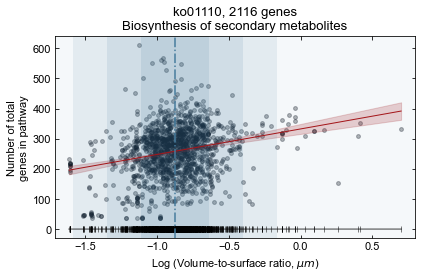

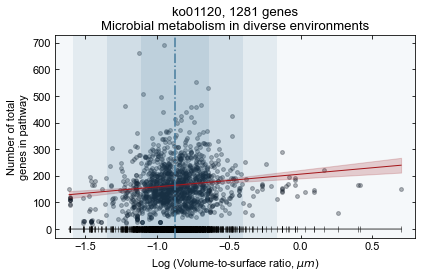

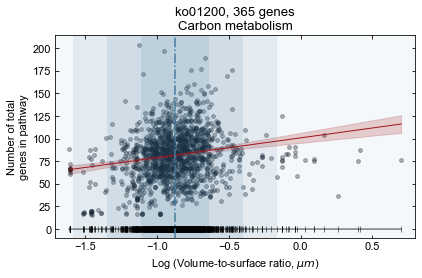

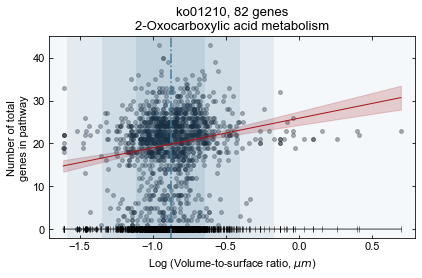

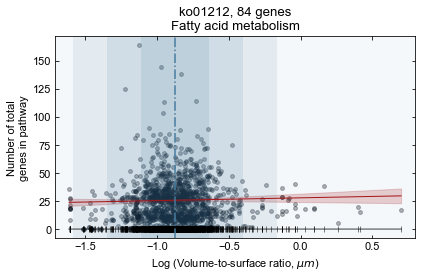

...

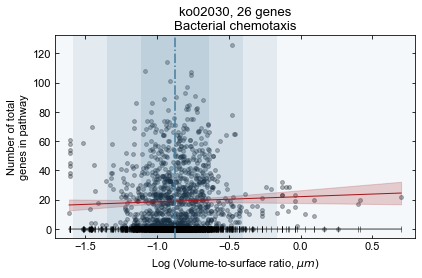

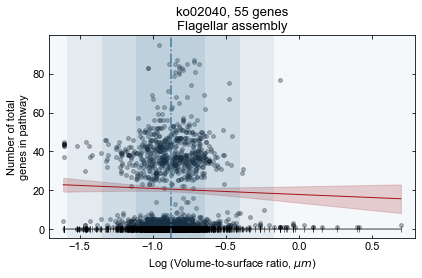

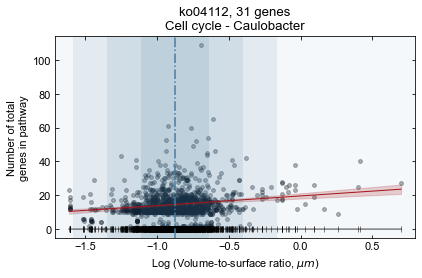

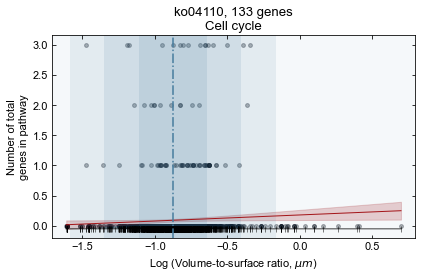

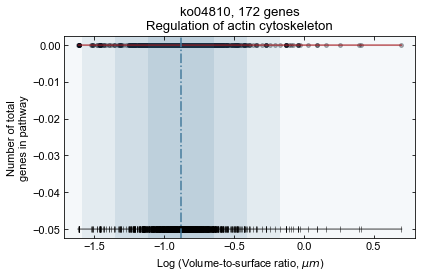

CPU times: user 37min 39s, sys: 1min 12s, total: 38min 52s
Wall time: 18min 42s


In [58]:
%%time
tmp = []
for pathway, genes in genes_pathways.items():
    
    # Get hits
    hits_all = find_hits_all_genes(genes)
    # Figure
    plt.figure()

    # Data
    x, y = df2[size], hits_all
    x_reg = sm.add_constant(x)

    # Linear regression
    reg = sm.OLS(y, x_reg).fit()
    intercept, slope = reg.params
    x_reg_ = np.linspace(x.min(), x.max(), x.shape[0])
    y_pred = reg.get_prediction(sm.add_constant(x_reg_))
    residuals = y - reg.predict()
    parameters = norm.fit(residuals)
    KS = kstest(residuals, 'norm', parameters)

    # Spearman correlation
    pr = spearmanr(x, y)

    # Plot
    plt.scatter(x, y, alpha = 0.3, color = '#000814', s = 15)
    plt.plot(x, np.full_like(x, -0.05), color = 'black', marker = '|',
                         alpha = 0.5)

    plt.plot(x, (x * slope + intercept), c = '#a4161a', lw = 1)
    plt.fill_between(x_reg_, *zip(*y_pred.conf_int()), color = '#a4161a', alpha = 0.2)


    # Mean and standard deviations
    plt.axvline(x = mu, color = '#457b9d', linestyle = 'dashdot', alpha = 1.0)
    for i in range(0, 4):
        low_r = mu + std * i
        up_r = mu + std * (i + 1)
        low_l = mu - std * i
        up_l = mu - std * (i + 1)
        if i == 3:
            up_r = x.max() + 0.1
            up_l = x.min() - 0.1
        plt.axvspan(low_r, up_r, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)
        plt.axvspan(low_l, up_l, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)

    plt.ylabel('Number of total\ngenes in pathway')
    plt.xlabel(f'Log (Volume-to-surface ratio, $\\mu m$)')
    plt.title(f'{pathway}, {len(genes)} genes\n{description_pathways[pathway]}')


    plt.xlim(x.min() - 0.1, x.max() + 0.1)
    plt.tick_params(top = True, right = True, direction = 'in', which = 'both')

    print(f'\nKEGG pathway: {pathway}, {description_pathways[pathway]}')
    print(f'OLS summary: {reg.summary()}')
    print(f'Nomality residuals: {KS}')
    print(f'Spearman rank correlation: {pr}')
    
    # Save to dataframe
    df2[f'hits_all_{pathway}'] = hits_all
    
    # Add values to table
    tmp.append([description_pathways[pathway], pathway, len(genes),
            reg.params[0], reg.bse[0], reg.pvalues[0],
            reg.params[1], reg.bse[1], reg.pvalues[1],
            reg.rsquared_adj, reg.aic])

# Save data frame
df_reg_all = pd.DataFrame(tmp, columns = ['Pathway name', 'ko', 'Number of genes',
                                          'Alpha', 'Standard error', 'P-value alpha',
                                         'Beta', 'Standard error', 'P-value beta',
                                         'R squared adj', 'AIC'])
df_reg_all.set_index('Pathway name', inplace = True)
df_reg_all.to_csv('kegg_lregress/all_genes.csv')
    
plt.show()

Total bp length of all genes


KEGG pathway: ko01110, Biosynthesis of secondary metabolites
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.056
Model:                            OLS   Adj. R-squared:                  0.055
Method:                 Least Squares   F-statistic:                     80.75
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           8.37e-19
Time:                        13:50:09   Log-Likelihood:                -17617.
No. Observations:                1361   AIC:                         3.524e+04
Df Residuals:                    1359   BIC:                         3.525e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------


KEGG pathway: ko01212, Fatty acid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.779
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0957
Time:                        13:56:08   Log-Likelihood:                -15574.
No. Observations:                1361   AIC:                         3.115e+04
Df Residuals:                    1359   BIC:                         3.116e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko01240, Biosynthesis of cofactors
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.112
Model:                            OLS   Adj. R-squared:                  0.111
Method:                 Least Squares   F-statistic:                     171.1
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.37e-37
Time:                        14:01:38   Log-Likelihood:                -16164.
No. Observations:                1361   AIC:                         3.233e+04
Df Residuals:                    1359   BIC:                         3.234e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00030, Pentose phosphate pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.041
Model:                            OLS   Adj. R-squared:                  0.040
Method:                 Least Squares   F-statistic:                     57.38
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.61e-14
Time:                        14:06:49   Log-Likelihood:                -14267.
No. Observations:                1361   AIC:                         2.854e+04
Df Residuals:                    1359   BIC:                         2.855e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00053, Ascorbate and aldarate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.053
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0247
Time:                        14:11:54   Log-Likelihood:                -13653.
No. Observations:                1361   AIC:                         2.731e+04
Df Residuals:                    1359   BIC:                         2.732e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

<timed exec>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



KEGG pathway: ko00630, Glyoxylate and dicarboxylate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.012
Model:                            OLS   Adj. R-squared:                  0.011
Method:                 Least Squares   F-statistic:                     15.98
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.76e-05
Time:                        14:17:23   Log-Likelihood:                -15477.
No. Observations:                1361   AIC:                         3.096e+04
Df Residuals:                    1359   BIC:                         3.097e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------


KEGG pathway: ko00562, Inositol phosphate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.106
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0782
Time:                        14:23:01   Log-Likelihood:                -13603.
No. Observations:                1361   AIC:                         2.721e+04
Df Residuals:                    1359   BIC:                         2.722e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------


KEGG pathway: ko00710, Carbon fixation in photosynthetic organisms
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.053
Model:                            OLS   Adj. R-squared:                  0.052
Method:                 Least Squares   F-statistic:                     75.50
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.03e-17
Time:                        14:28:33   Log-Likelihood:                -13635.
No. Observations:                1361   AIC:                         2.727e+04
Df Residuals:                    1359   BIC:                         2.728e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------


KEGG pathway: ko00920, Sulfur metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.016
Method:                 Least Squares   F-statistic:                     23.67
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.28e-06
Time:                        14:34:22   Log-Likelihood:                -14656.
No. Observations:                1361   AIC:                         2.932e+04
Df Residuals:                    1359   BIC:                         2.933e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------


KEGG pathway: ko00073, Cutin, suberine and wax biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.2448
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.621
Time:                        14:39:48   Log-Likelihood:                -9865.8
No. Observations:                1361   AIC:                         1.974e+04
Df Residuals:                    1359   BIC:                         1.975e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00140, Steroid hormone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.365
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.124
Time:                        14:45:23   Log-Likelihood:                -10697.
No. Observations:                1361   AIC:                         2.140e+04
Df Residuals:                    1359   BIC:                         2.141e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00600, Sphingolipid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.02967
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.863
Time:                        14:51:02   Log-Likelihood:                -14727.
No. Observations:                1361   AIC:                         2.946e+04
Df Residuals:                    1359   BIC:                         2.947e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko01040, Biosynthesis of unsaturated fatty acids
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.3931
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.531
Time:                        14:56:28   Log-Likelihood:                -12607.
No. Observations:                1361   AIC:                         2.522e+04
Df Residuals:                    1359   BIC:                         2.523e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------


KEGG pathway: ko00260, Glycine, serine and threonine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.011
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     14.95
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000116
Time:                        15:02:23   Log-Likelihood:                -15102.
No. Observations:                1361   AIC:                         3.021e+04
Df Residuals:                    1359   BIC:                         3.022e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko00300, Lysine biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.054
Model:                            OLS   Adj. R-squared:                  0.054
Method:                 Least Squares   F-statistic:                     77.98
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.15e-18
Time:                        15:07:59   Log-Likelihood:                -13402.
No. Observations:                1361   AIC:                         2.681e+04
Df Residuals:                    1359   BIC:                         2.682e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00340, Histidine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.017
Method:                 Least Squares   F-statistic:                     24.07
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.04e-06
Time:                        15:13:30   Log-Likelihood:                -13660.
No. Observations:                1361   AIC:                         2.732e+04
Df Residuals:                    1359   BIC:                         2.733e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00400, Phenylalanine, tyrosine and tryptophan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.057
Model:                            OLS   Adj. R-squared:                  0.057
Method:                 Least Squares   F-statistic:                     82.80
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.13e-19
Time:                        15:19:09   Log-Likelihood:                -13931.
No. Observations:                1361   AIC:                         2.787e+04
Df Residuals:                    1359   BIC:                         2.788e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------


KEGG pathway: ko00450, Selenocompound metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     7.218
Date:                Wed, 01 Nov 2023   Prob (F-statistic):            0.00730
Time:                        15:24:30   Log-Likelihood:                -13625.
No. Observations:                1361   AIC:                         2.725e+04
Df Residuals:                    1359   BIC:                         2.726e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00510, N-Glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.036
Model:                            OLS   Adj. R-squared:                  0.035
Method:                 Least Squares   F-statistic:                     50.23
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.19e-12
Time:                        15:29:57   Log-Likelihood:                -11351.
No. Observations:                1361   AIC:                         2.271e+04
Df Residuals:                    1359   BIC:                         2.272e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00512, Mucin type O-glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        15:32:45   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------


KEGG pathway: ko00534, Glycosaminoglycan biosynthesis - heparan sulfate / heparin
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.02964
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.863
Time:                        15:38:16   Log-Likelihood:                -8487.4
No. Observations:                1361   AIC:                         1.698e+04
Df Residuals:                    1359   BIC:                         1.699e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00533, Glycosaminoglycan biosynthesis - keratan sulfate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        15:39:43   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00601, Glycosphingolipid biosynthesis - lacto and neolacto series
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        15:43:56   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------


KEGG pathway: ko00540, Lipopolysaccharide biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.4249
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.515
Time:                        15:49:31   Log-Likelihood:                -14307.
No. Observations:                1361   AIC:                         2.862e+04
Df Residuals:                    1359   BIC:                         2.863e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko00552, Teichoic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.032
Model:                            OLS   Adj. R-squared:                  0.032
Method:                 Least Squares   F-statistic:                     45.57
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.18e-11
Time:                        15:55:10   Log-Likelihood:                -14376.
No. Observations:                1361   AIC:                         2.876e+04
Df Residuals:                    1359   BIC:                         2.877e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00730, Thiamine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.090
Model:                            OLS   Adj. R-squared:                  0.089
Method:                 Least Squares   F-statistic:                     133.7
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.47e-29
Time:                        16:00:13   Log-Likelihood:                -13294.
No. Observations:                1361   AIC:                         2.659e+04
Df Residuals:                    1359   BIC:                         2.660e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00770, Pantothenate and CoA biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.037
Model:                            OLS   Adj. R-squared:                  0.036
Method:                 Least Squares   F-statistic:                     52.50
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.18e-13
Time:                        16:05:12   Log-Likelihood:                -13738.
No. Observations:                1361   AIC:                         2.748e+04
Df Residuals:                    1359   BIC:                         2.749e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------


KEGG pathway: ko00670, One carbon pool by folate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.016
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     22.35
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.51e-06
Time:                        16:10:08   Log-Likelihood:                -13175.
No. Observations:                1361   AIC:                         2.635e+04
Df Residuals:                    1359   BIC:                         2.636e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko00900, Terpenoid backbone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.006
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     8.453
Date:                Wed, 01 Nov 2023   Prob (F-statistic):            0.00370
Time:                        16:15:10   Log-Likelihood:                -13810.
No. Observations:                1361   AIC:                         2.762e+04
Df Residuals:                    1359   BIC:                         2.763e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00902, Monoterpenoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        16:16:25   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00904, Diterpenoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        16:18:55   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00905, Brassinosteroid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        16:21:23   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00907, Pinene, camphor and geraniol degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.6673
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.414
Time:                        16:26:25   Log-Likelihood:                -13700.
No. Observations:                1361   AIC:                         2.740e+04
Df Residuals:                    1359   BIC:                         2.741e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko01059, Biosynthesis of enediyne antibiotics
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.7232
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.395
Time:                        16:31:39   Log-Likelihood:                -13866.
No. Observations:                1361   AIC:                         2.774e+04
Df Residuals:                    1359   BIC:                         2.775e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00523, Polyketide sugar unit biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.024
Model:                            OLS   Adj. R-squared:                  0.024
Method:                 Least Squares   F-statistic:                     33.83
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.51e-09
Time:                        16:36:47   Log-Likelihood:                -12273.
No. Observations:                1361   AIC:                         2.455e+04
Df Residuals:                    1359   BIC:                         2.456e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------


KEGG pathway: ko00940, Phenylpropanoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     6.120
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0135
Time:                        16:41:55   Log-Likelihood:                -11822.
No. Observations:                1361   AIC:                         2.365e+04
Df Residuals:                    1359   BIC:                         2.366e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00942, Anthocyanin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        16:47:08   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00943, Isoflavonoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        16:48:25   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00403, Indole diterpene alkaloid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        16:52:26   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------


KEGG pathway: ko00232, Caffeine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.08225
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.774
Time:                        16:57:34   Log-Likelihood:                -9422.9
No. Observations:                1361   AIC:                         1.885e+04
Df Residuals:                    1359   BIC:                         1.886e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00402, Benzoxazinoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        17:01:22   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00331, Clavulanic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.06639
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.797
Time:                        17:06:27   Log-Likelihood:                -8397.9
No. Observations:                1361   AIC:                         1.680e+04
Df Residuals:                    1359   BIC:                         1.681e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00401, Novobiocin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     20.54
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.34e-06
Time:                        17:11:39   Log-Likelihood:                -12366.
No. Observations:                1361   AIC:                         2.474e+04
Df Residuals:                    1359   BIC:                         2.475e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00254, Aflatoxin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        17:17:02   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko00362, Benzoate degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                 0.0009586
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.975
Time:                        17:22:17   Log-Likelihood:                -15215.
No. Observations:                1361   AIC:                         3.043e+04
Df Residuals:                    1359   BIC:                         3.045e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00361, Chlorocyclohexane and chlorobenzene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.027
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0251
Time:                        17:27:42   Log-Likelihood:                -12771.
No. Observations:                1361   AIC:                         2.555e+04
Df Residuals:                    1359   BIC:                         2.556e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------


KEGG pathway: ko00642, Ethylbenzene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1912
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.662
Time:                        17:32:49   Log-Likelihood:                -11921.
No. Observations:                1361   AIC:                         2.385e+04
Df Residuals:                    1359   BIC:                         2.386e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------


KEGG pathway: ko00363, Bisphenol degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.7114
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.399
Time:                        17:37:45   Log-Likelihood:                -10028.
No. Observations:                1361   AIC:                         2.006e+04
Df Residuals:                    1359   BIC:                         2.007e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko00365, Furfural degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.334
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.248
Time:                        17:42:40   Log-Likelihood:                -11396.
No. Observations:                1361   AIC:                         2.280e+04
Df Residuals:                    1359   BIC:                         2.281e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------


KEGG pathway: ko00983, Drug metabolism - other enzymes
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.8206
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.365
Time:                        17:47:34   Log-Likelihood:                -13355.
No. Observations:                1361   AIC:                         2.671e+04
Df Residuals:                    1359   BIC:                         2.672e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko03010, Ribosome
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     1.863
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.173
Time:                        17:52:39   Log-Likelihood:                -11795.
No. Observations:                1361   AIC:                         2.359e+04
Df Residuals:                    1359   BIC:                         2.360e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
cons


KEGG pathway: ko03008, Ribosome biogenesis in eukaryotes
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     14.28
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000165
Time:                        17:57:44   Log-Likelihood:                -12092.
No. Observations:                1361   AIC:                         2.419e+04
Df Residuals:                    1359   BIC:                         2.420e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04130, SNARE interactions in vesicular transport
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:01:30   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------


KEGG pathway: ko03018, RNA degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.016
Method:                 Least Squares   F-statistic:                     23.54
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.37e-06
Time:                        18:06:32   Log-Likelihood:                -13695.
No. Observations:                1361   AIC:                         2.739e+04
Df Residuals:                    1359   BIC:                         2.740e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------


KEGG pathway: ko03430, Mismatch repair
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                  0.016
Method:                 Least Squares   F-statistic:                     23.04
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.76e-06
Time:                        18:11:31   Log-Likelihood:                -13998.
No. Observations:                1361   AIC:                         2.800e+04
Df Residuals:                    1359   BIC:                         2.801e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03230, Viral genome structure
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:16:34   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03240, Viral replication
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:17:53   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03260, Virion - Human immunodeficiency virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:20:21   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03262, Virion - Coronavirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:21:34   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03261, Virion - Influenza A virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:22:47   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03263, Virion - Enterovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:24:00   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03264, Virion - Flavivirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:25:13   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03265, Virion - Lyssavirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:26:26   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03266, Virion - Herpesvirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:27:39   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03268, Virion - Orthopoxvirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:28:53   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03267, Virion - Adenovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:30:06   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko02020, Two-component system
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.040
Model:                            OLS   Adj. R-squared:                  0.040
Method:                 Least Squares   F-statistic:                     57.02
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.88e-14
Time:                        18:35:42   Log-Likelihood:                -17302.
No. Observations:                1361   AIC:                         3.461e+04
Df Residuals:                    1359   BIC:                         3.462e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04010, MAPK signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:37:03   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04012, ErbB signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:42:05   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04015, Rap1 signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:44:44   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04341, Hedgehog signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.7603
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.383
Time:                        18:49:45   Log-Likelihood:                -9087.2
No. Observations:                1361   AIC:                         1.818e+04
Df Residuals:                    1359   BIC:                         1.819e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04350, TGF-beta signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:51:01   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04390, Hippo signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:52:19   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04391, Hippo signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:53:37   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04392, Hippo signaling pathway - multiple species
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:54:50   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04630, JAK-STAT signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        18:58:39   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko04068, FoxO signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.299
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.255
Time:                        19:03:43   Log-Likelihood:                -12419.
No. Observations:                1361   AIC:                         2.484e+04
Df Residuals:                    1359   BIC:                         2.485e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04071, Sphingolipid signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1299
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.719
Time:                        19:08:50   Log-Likelihood:                -12107.
No. Observations:                1361   AIC:                         2.422e+04
Df Residuals:                    1359   BIC:                         2.423e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------


KEGG pathway: ko04152, AMPK signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.298
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0696
Time:                        19:14:06   Log-Likelihood:                -11846.
No. Observations:                1361   AIC:                         2.370e+04
Df Residuals:                    1359   BIC:                         2.371e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04060, Cytokine-cytokine receptor interaction
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:19:26   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04061, Viral protein interaction with cytokine and cytokine receptor
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:20:43   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04514, Cell adhesion molecules
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:23:16   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko02026, Biofilm formation - Escherichia coli
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.038
Model:                            OLS   Adj. R-squared:                  0.037
Method:                 Least Squares   F-statistic:                     53.61
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           4.17e-13
Time:                        19:28:29   Log-Likelihood:                -14763.
No. Observations:                1361   AIC:                         2.953e+04
Df Residuals:                    1359   BIC:                         2.954e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko04110, Cell cycle
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     4.211
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0404
Time:                        19:33:28   Log-Likelihood:                -9748.1
No. Observations:                1361   AIC:                         1.950e+04
Df Residuals:                    1359   BIC:                         1.951e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
co

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04810, Regulation of actin cytoskeleton
OLS summary:                             OLS Regression Results                            
Dep. Variable:                      y   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:34:47   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

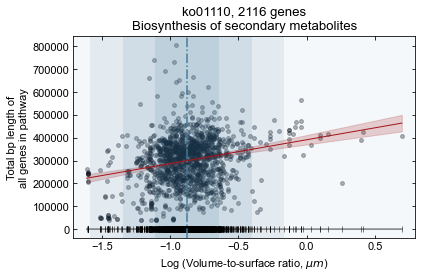

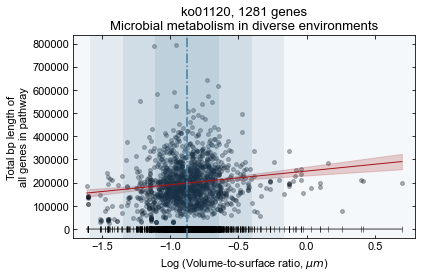

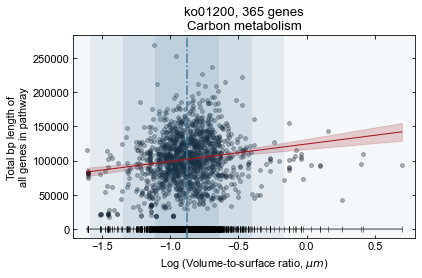

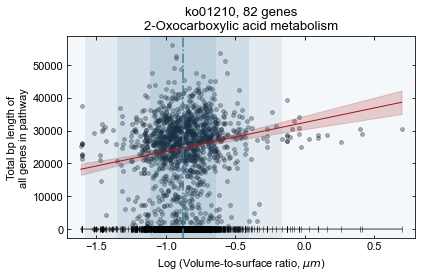

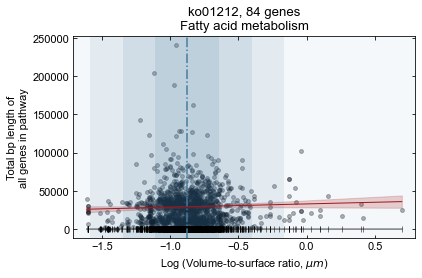

...

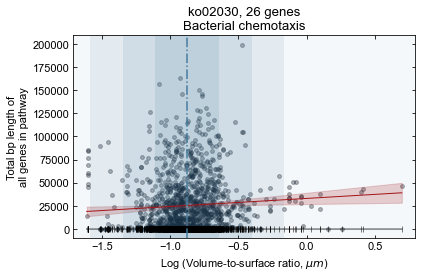

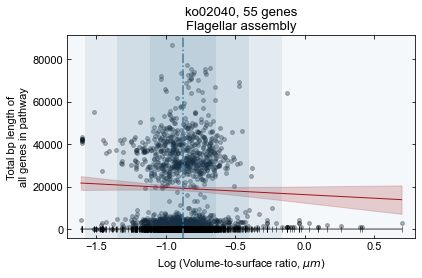

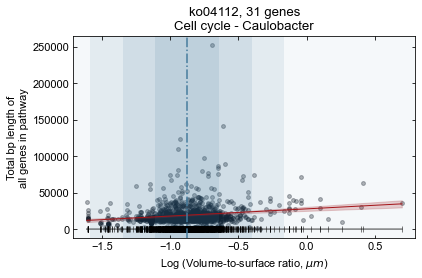

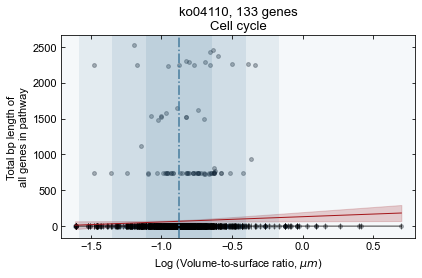

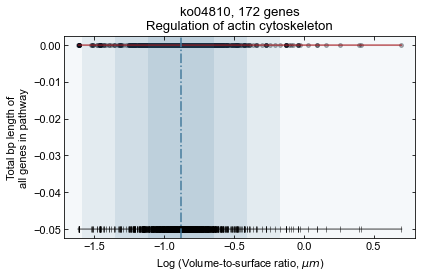

CPU times: user 6h 5min 47s, sys: 2min 14s, total: 6h 8min 2s
Wall time: 5h 47min 51s


In [59]:
%%time
hits_all_bp_dict = {}
tmp = []
for pathway, genes in genes_pathways.items():
    
    # Get hits
    hits_all_bp = find_hits_all_base_pairs(genes, orfs, kos_all_orfs, orfs_genome)
    hits_all_bp_dict[pathway] = hits_all_bp
    # Figure
    plt.figure()

    # Data
    x, y = df2[size], hits_all_bp
    x_reg = sm.add_constant(x)

    # Linear regression
    reg = sm.OLS(y, x_reg).fit()
    intercept, slope = reg.params
    x_reg_ = np.linspace(x.min(), x.max(), x.shape[0])
    y_pred = reg.get_prediction(sm.add_constant(x_reg_))
    residuals = y - reg.predict()
    parameters = norm.fit(residuals)
    KS = kstest(residuals, 'norm', parameters)

    # Spearman correlation
    pr = spearmanr(x, y)

    # Plot
    plt.scatter(x, y, alpha = 0.3, color = '#000814', s = 15)
    plt.plot(x, np.full_like(x, -0.05), color = 'black', marker = '|',
                         alpha = 0.5)

    plt.plot(x, (x * slope + intercept), c = '#a4161a', lw = 1)
    plt.fill_between(x_reg_, *zip(*y_pred.conf_int()), color = '#a4161a', alpha = 0.2)


    # Mean and standard deviations
    plt.axvline(x = mu, color = '#457b9d', linestyle = 'dashdot', alpha = 1.0)
    for i in range(0, 4):
        low_r = mu + std * i
        up_r = mu + std * (i + 1)
        low_l = mu - std * i
        up_l = mu - std * (i + 1)
        if i == 3:
            up_r = x.max() + 0.1
            up_l = x.min() - 0.1
        plt.axvspan(low_r, up_r, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)
        plt.axvspan(low_l, up_l, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)

    plt.ylabel('Total bp length of\nall genes in pathway')
    plt.xlabel(f'Log (Volume-to-surface ratio, $\\mu m$)')
    plt.title(f'{pathway}, {len(genes)} genes\n{description_pathways[pathway]}')


    plt.xlim(x.min() - 0.1, x.max() + 0.1)
    plt.tick_params(top = True, right = True, direction = 'in', which = 'both')

    print(f'\nKEGG pathway: {pathway}, {description_pathways[pathway]}')
    print(f'OLS summary: {reg.summary()}')
    print(f'Nomality residuals: {KS}')
    print(f'Spearman rank correlation: {pr}')
    
    # Save to dataframe
    df2[f'hits_all_bp_{pathway}'] = hits_all_bp
    
    # Add values to table
    tmp.append([description_pathways[pathway], pathway, len(genes),
            reg.params[0], reg.bse[0], reg.pvalues[0],
            reg.params[1], reg.bse[1], reg.pvalues[1],
            reg.rsquared_adj, reg.aic])

# Save data frame
df_reg_all_bp = pd.DataFrame(tmp, columns = ['Pathway name', 'ko', 'Number of genes',
                                          'Alpha', 'Standard error', 'P-value alpha',
                                         'Beta', 'Standard error', 'P-value beta',
                                         'R squared adj', 'AIC'])
df_reg_all_bp.set_index('Pathway name', inplace = True)
df_reg_all_bp.to_csv('kegg_lregress/all_bp.csv')
    
plt.show()

Fraction of bp length of all genes in pathway to species genome size


KEGG pathway: ko01110, Biosynthesis of secondary metabolites
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.2923
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.589
Time:                        19:35:32   Log-Likelihood:                 3550.6
No. Observations:                1361   AIC:                            -7097.
Df Residuals:                    1359   BIC:                            -7087.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------


KEGG pathway: ko01230, Biosynthesis of amino acids
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.2054
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.651
Time:                        19:35:32   Log-Likelihood:                 4453.0
No. Observations:                1361   AIC:                            -8902.
Df Residuals:                    1359   BIC:                            -8892.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------


KEGG pathway: ko01220, Degradation of aromatic compounds
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.4310
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.512
Time:                        19:35:33   Log-Likelihood:                 6408.1
No. Observations:                1361   AIC:                        -1.281e+04
Df Residuals:                    1359   BIC:                        -1.280e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------


KEGG pathway: ko00051, Fructose and mannose metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     13.78
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000214
Time:                        19:35:33   Log-Likelihood:                 6315.7
No. Observations:                1361   AIC:                        -1.263e+04
Df Residuals:                    1359   BIC:                        -1.262e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko00520, Amino sugar and nucleotide sugar metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     4.393
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0363
Time:                        19:35:34   Log-Likelihood:                 5760.8
No. Observations:                1361   AIC:                        -1.152e+04
Df Residuals:                    1359   BIC:                        -1.151e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------

<timed exec>:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



KEGG pathway: ko00640, Propanoate metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     14.41
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000153
Time:                        19:35:34   Log-Likelihood:                 6077.5
No. Observations:                1361   AIC:                        -1.215e+04
Df Residuals:                    1359   BIC:                        -1.214e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko00195, Photosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.045
Model:                            OLS   Adj. R-squared:                  0.044
Method:                 Least Squares   F-statistic:                     63.83
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           2.87e-15
Time:                        19:35:34   Log-Likelihood:                 6990.0
No. Observations:                1361   AIC:                        -1.398e+04
Df Residuals:                    1359   BIC:                        -1.397e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------


KEGG pathway: ko00680, Methane metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.140
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0766
Time:                        19:35:35   Log-Likelihood:                 4637.4
No. Observations:                1361   AIC:                            -9271.
Df Residuals:                    1359   BIC:                            -9260.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------


KEGG pathway: ko00062, Fatty acid elongation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1927
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.661
Time:                        19:35:37   Log-Likelihood:                 11845.
No. Observations:                1361   AIC:                        -2.369e+04
Df Residuals:                    1359   BIC:                        -2.368e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko00140, Steroid hormone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.476
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.116
Time:                        19:35:37   Log-Likelihood:                 10024.
No. Observations:                1361   AIC:                        -2.004e+04
Df Residuals:                    1359   BIC:                        -2.003e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko00591, Linoleic acid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     10.24
Date:                Wed, 01 Nov 2023   Prob (F-statistic):            0.00141
Time:                        19:35:38   Log-Likelihood:                 9778.3
No. Observations:                1361   AIC:                        -1.955e+04
Df Residuals:                    1359   BIC:                        -1.954e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------


KEGG pathway: ko00260, Glycine, serine and threonine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.973
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0849
Time:                        19:35:38   Log-Likelihood:                 5888.2
No. Observations:                1361   AIC:                        -1.177e+04
Df Residuals:                    1359   BIC:                        -1.176e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------


KEGG pathway: ko00220, Arginine biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.3548
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.551
Time:                        19:35:39   Log-Likelihood:                 6587.9
No. Observations:                1361   AIC:                        -1.317e+04
Df Residuals:                    1359   BIC:                        -1.316e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------


KEGG pathway: ko00400, Phenylalanine, tyrosine and tryptophan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.6617
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.416
Time:                        19:35:39   Log-Likelihood:                 6322.1
No. Observations:                1361   AIC:                        -1.264e+04
Df Residuals:                    1359   BIC:                        -1.263e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------


KEGG pathway: ko00470, D-Amino acid metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.471
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.116
Time:                        19:35:40   Log-Likelihood:                 6743.3
No. Observations:                1361   AIC:                        -1.348e+04
Df Residuals:                    1359   BIC:                        -1.347e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00514, Other types of O-glycan biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.062
Model:                            OLS   Adj. R-squared:                  0.062
Method:                 Least Squares   F-statistic:                     90.56
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.88e-21
Time:                        19:35:41   Log-Likelihood:                 8103.2
No. Observations:                1361   AIC:                        -1.620e+04
Df Residuals:                    1359   BIC:                        -1.619e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00533, Glycosaminoglycan biosynthesis - keratan sulfate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:41   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00601, Glycosphingolipid biosynthesis - lacto and neolacto series
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:41   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------


KEGG pathway: ko00540, Lipopolysaccharide biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     13.20
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000291
Time:                        19:35:41   Log-Likelihood:                 6165.1
No. Observations:                1361   AIC:                        -1.233e+04
Df Residuals:                    1359   BIC:                        -1.232e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------


KEGG pathway: ko00552, Teichoic acid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     20.23
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.46e-06
Time:                        19:35:41   Log-Likelihood:                 6337.7
No. Observations:                1361   AIC:                        -1.267e+04
Df Residuals:                    1359   BIC:                        -1.266e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko00730, Thiamine metabolism
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     1.773
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.183
Time:                        19:35:42   Log-Likelihood:                 7172.6
No. Observations:                1361   AIC:                        -1.434e+04
Df Residuals:                    1359   BIC:                        -1.433e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------


KEGG pathway: ko00770, Pantothenate and CoA biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.03916
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.843
Time:                        19:35:42   Log-Likelihood:                 6993.4
No. Observations:                1361   AIC:                        -1.398e+04
Df Residuals:                    1359   BIC:                        -1.397e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------


KEGG pathway: ko00670, One carbon pool by folate
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.031
Model:                            OLS   Adj. R-squared:                  0.030
Method:                 Least Squares   F-statistic:                     43.03
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.65e-11
Time:                        19:35:42   Log-Likelihood:                 7412.3
No. Observations:                1361   AIC:                        -1.482e+04
Df Residuals:                    1359   BIC:                        -1.481e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW

OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.028
Model:                            OLS   Adj. R-squared:                  0.027
Method:                 Least Squares   F-statistic:                     38.45
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           7.45e-10
Time:                        19:35:43   Log-Likelihood:                 9863.1
No. Observations:                1361   AIC:                        -1.972e+04
Df Residuals:                    1359   BIC:                        -1.971e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const           0.0002   1.79e-05    

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00981, Insect hormone biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.446
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.229
Time:                        19:35:43   Log-Likelihood:                 9304.0
No. Observations:                1361   AIC:                        -1.860e+04
Df Residuals:                    1359   BIC:                        -1.859e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------


KEGG pathway: ko01059, Biosynthesis of enediyne antibiotics
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.675
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.102
Time:                        19:35:43   Log-Likelihood:                 7242.5
No. Observations:                1361   AIC:                        -1.448e+04
Df Residuals:                    1359   BIC:                        -1.447e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------


KEGG pathway: ko00523, Polyketide sugar unit biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     3.037
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0816
Time:                        19:35:44   Log-Likelihood:                 8108.1
No. Observations:                1361   AIC:                        -1.621e+04
Df Residuals:                    1359   BIC:                        -1.620e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------


KEGG pathway: ko00940, Phenylpropanoid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.2118
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.645
Time:                        19:35:44   Log-Likelihood:                 8906.5
No. Observations:                1361   AIC:                        -1.781e+04
Df Residuals:                    1359   BIC:                        -1.780e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00942, Anthocyanin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:44   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00403, Indole diterpene alkaloid biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:44   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------


KEGG pathway: ko00966, Glucosinolate biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                  0.004785
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.945
Time:                        19:35:45   Log-Likelihood:                 8800.5
No. Observations:                1361   AIC:                        -1.760e+04
Df Residuals:                    1359   BIC:                        -1.759e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00261, Monobactam biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     4.020
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0452
Time:                        19:35:45   Log-Likelihood:                 7621.3
No. Observations:                1361   AIC:                        -1.524e+04
Df Residuals:                    1359   BIC:                        -1.523e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko00525, Acarbose and validamycin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.303
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.129
Time:                        19:35:45   Log-Likelihood:                 8728.9
No. Observations:                1361   AIC:                        -1.745e+04
Df Residuals:                    1359   BIC:                        -1.744e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------


KEGG pathway: ko00333, Prodigiosin biosynthesis
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.021
Model:                            OLS   Adj. R-squared:                  0.020
Method:                 Least Squares   F-statistic:                     28.92
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           8.86e-08
Time:                        19:35:45   Log-Likelihood:                 7605.9
No. Observations:                1361   AIC:                        -1.521e+04
Df Residuals:                    1359   BIC:                        -1.520e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko00997, Biosynthesis of various other secondary metabolites
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.3864
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.534
Time:                        19:35:46   Log-Likelihood:                 8908.9
No. Observations:                1361   AIC:                        -1.781e+04
Df Residuals:                    1359   BIC:                        -1.780e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------


KEGG pathway: ko00625, Chloroalkane and chloroalkene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.024
Model:                            OLS   Adj. R-squared:                  0.023
Method:                 Least Squares   F-statistic:                     33.17
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           1.04e-08
Time:                        19:35:46   Log-Likelihood:                 7949.6
No. Observations:                1361   AIC:                        -1.590e+04
Df Residuals:                    1359   BIC:                        -1.588e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------


KEGG pathway: ko00633, Nitrotoluene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.556
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.212
Time:                        19:35:46   Log-Likelihood:                 7474.6
No. Observations:                1361   AIC:                        -1.495e+04
Df Residuals:                    1359   BIC:                        -1.493e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------


KEGG pathway: ko00626, Naphthalene degradation
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     13.24
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000285
Time:                        19:35:47   Log-Likelihood:                 8478.6
No. Observations:                1361   AIC:                        -1.695e+04
Df Residuals:                    1359   BIC:                        -1.694e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------


KEGG pathway: ko00980, Metabolism of xenobiotics by cytochrome P450
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.098
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0241
Time:                        19:35:47   Log-Likelihood:                 7778.2
No. Observations:                1361   AIC:                        -1.555e+04
Df Residuals:                    1359   BIC:                        -1.554e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------


KEGG pathway: ko03022, Basal transcription factors
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     3.527
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0606
Time:                        19:35:47   Log-Likelihood:                 7944.1
No. Observations:                1361   AIC:                        -1.588e+04
Df Residuals:                    1359   BIC:                        -1.587e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------


KEGG pathway: ko03013, Nucleocytoplasmic transport
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     4.533
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0334
Time:                        19:35:47   Log-Likelihood:                 9221.5
No. Observations:                1361   AIC:                        -1.844e+04
Df Residuals:                    1359   BIC:                        -1.843e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------


KEGG pathway: ko04141, Protein processing in endoplasmic reticulum
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                 0.0002676
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.987
Time:                        19:35:48   Log-Likelihood:                 7783.7
No. Observations:                1361   AIC:                        -1.556e+04
Df Residuals:                    1359   BIC:                        -1.555e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03050, Proteasome
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     2.463
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.117
Time:                        19:35:48   Log-Likelihood:                 8652.4
No. Observations:                1361   AIC:                        -1.730e+04
Df Residuals:                    1359   BIC:                        -1.729e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
co


KEGG pathway: ko03420, Nucleotide excision repair
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.072
Model:                            OLS   Adj. R-squared:                  0.071
Method:                 Least Squares   F-statistic:                     105.0
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           8.85e-24
Time:                        19:35:48   Log-Likelihood:                 6287.7
No. Observations:                1361   AIC:                        -1.257e+04
Df Residuals:                    1359   BIC:                        -1.256e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------


KEGG pathway: ko03460, Fanconi anemia pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.081
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0243
Time:                        19:35:48   Log-Likelihood:                 8836.5
No. Observations:                1361   AIC:                        -1.767e+04
Df Residuals:                    1359   BIC:                        -1.766e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko03260, Virion - Human immunodeficiency virus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:49   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/stats/stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: Runtim


KEGG pathway: ko03264, Virion - Flavivirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:49   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/stats/stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: Runtim


KEGG pathway: ko03267, Virion - Adenovirus
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:49   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/stats/stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)


OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     11.24
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           0.000821
Time:                        19:35:49   Log-Likelihood:                 5781.6
No. Observations:                1361   AIC:                        -1.156e+04
Df Residuals:                    1359   BIC:                        -1.155e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const           0.0049      0.000    

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04016, MAPK signaling pathway - plant
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.004
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     5.482
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0194
Time:                        19:35:49   Log-Likelihood:                 7807.7
No. Observations:                1361   AIC:                        -1.561e+04
Df Residuals:                    1359   BIC:                        -1.560e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04015, Rap1 signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:50   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04341, Hedgehog signaling pathway - fly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.8037
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.370
Time:                        19:35:50   Log-Likelihood:                 11784.
No. Observations:                1361   AIC:                        -2.356e+04
Df Residuals:                    1359   BIC:                        -2.355e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04392, Hippo signaling pathway - multiple species
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:50   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/stats/stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: Runtim


KEGG pathway: ko04064, NF-kappa B signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.2129
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.645
Time:                        19:35:50   Log-Likelihood:                 13893.
No. Observations:                1361   AIC:                        -2.778e+04
Df Residuals:                    1359   BIC:                        -2.777e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------


KEGG pathway: ko04020, Calcium signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.021
Model:                            OLS   Adj. R-squared:                  0.021
Method:                 Least Squares   F-statistic:                     29.58
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           6.36e-08
Time:                        19:35:51   Log-Likelihood:                 10274.
No. Observations:                1361   AIC:                        -2.054e+04
Df Residuals:                    1359   BIC:                        -2.053e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------


KEGG pathway: ko04024, cAMP signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.006
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     8.100
Date:                Wed, 01 Nov 2023   Prob (F-statistic):            0.00449
Time:                        19:35:51   Log-Likelihood:                 9513.8
No. Observations:                1361   AIC:                        -1.902e+04
Df Residuals:                    1359   BIC:                        -1.901e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------


KEGG pathway: ko04150, mTOR signaling pathway
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     4.736
Date:                Wed, 01 Nov 2023   Prob (F-statistic):             0.0297
Time:                        19:35:51   Log-Likelihood:                 11355.
No. Observations:                1361   AIC:                        -2.271e+04
Df Residuals:                    1359   BIC:                        -2.269e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW


KEGG pathway: ko04061, Viral protein interaction with cytokine and cytokine receptor
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                         nan
Model:                            OLS   Adj. R-squared:                    nan
Method:                 Least Squares   F-statistic:                       nan
Date:                Wed, 01 Nov 2023   Prob (F-statistic):                nan
Time:                        19:35:51   Log-Likelihood:                    inf
No. Observations:                1361   AIC:                              -inf
Df Residuals:                    1359   BIC:                              -inf
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/stats/stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)



KEGG pathway: ko05111, Biofilm formation - Vibrio cholerae
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                    0.1428
Date:                Wed, 01 Nov 2023   Prob (F-statistic):              0.706
Time:                        19:35:52   Log-Likelihood:                 6115.2
No. Observations:                1361   AIC:                        -1.223e+04
Df Residuals:                    1359   BIC:                        -1.222e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------


KEGG pathway: ko02040, Flagellar assembly
OLS summary:                             OLS Regression Results                            
Dep. Variable:                 genome   R-squared:                       0.016
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     21.82
Date:                Wed, 01 Nov 2023   Prob (F-statistic):           3.30e-06
Time:                        19:35:52   Log-Likelihood:                 5162.5
No. Observations:                1361   AIC:                        -1.032e+04
Df Residuals:                    1359   BIC:                        -1.031e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------

/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1919: RuntimeWarning: invalid value encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
/home/hsecaira/miniconda/envs/CellSize/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:903: RuntimeW

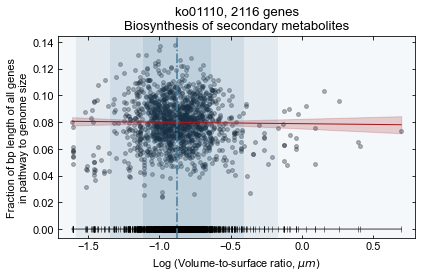

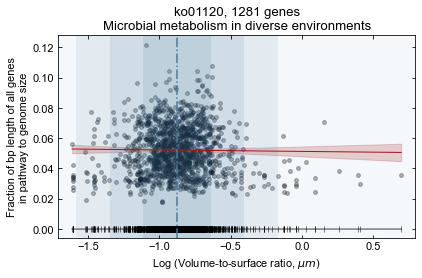

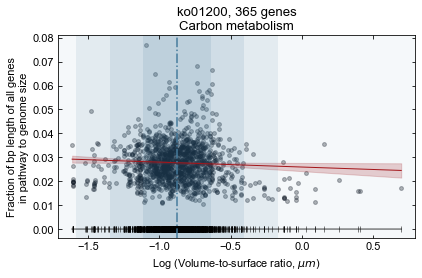

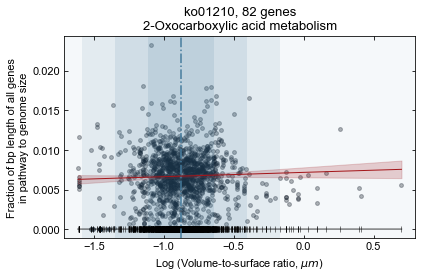

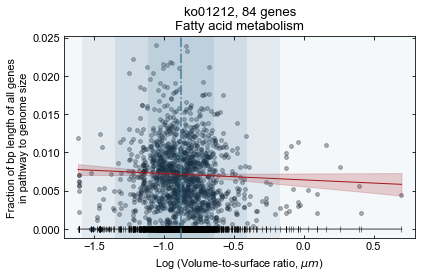

...

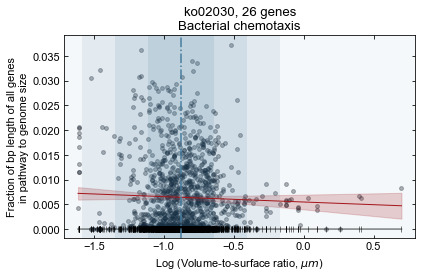

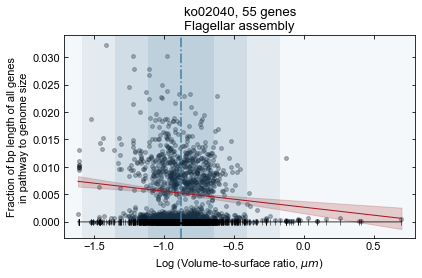

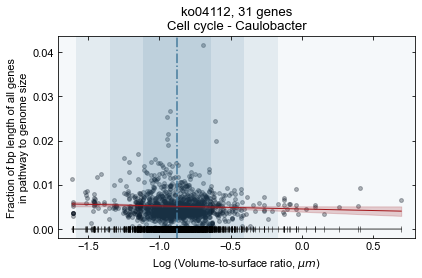

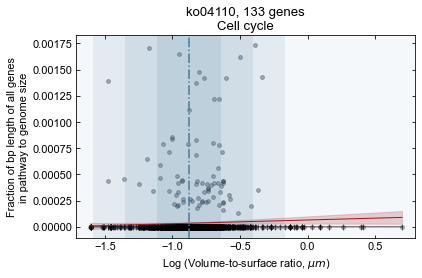

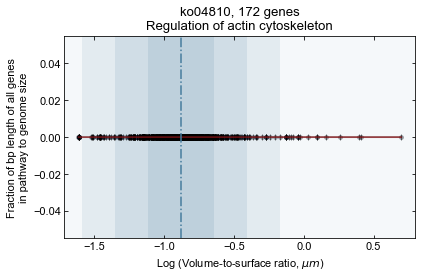

CPU times: user 7min 42s, sys: 25.6 s, total: 8min 7s
Wall time: 1min 8s


In [60]:
%%time
tmp = []
for pathway, genes in genes_pathways.items():
    
    # Get hits
    hits_all_bp_genome_size = hits_all_bp_dict[pathway] / df2['genome']
    # Figure
    plt.figure()

    # Data
    x, y = df2[size], hits_all_bp_genome_size
    x_reg = sm.add_constant(x)

    # Linear regression
    reg = sm.OLS(y, x_reg).fit()
    intercept, slope = reg.params
    x_reg_ = np.linspace(x.min(), x.max(), x.shape[0])
    y_pred = reg.get_prediction(sm.add_constant(x_reg_))
    residuals = y - reg.predict()
    parameters = norm.fit(residuals)
    KS = kstest(residuals, 'norm', parameters)

    # Spearman correlation
    pr = spearmanr(x, y)

    # Plot
    plt.scatter(x, y, alpha = 0.3, color = '#000814', s = 15)
    plt.plot(x, np.full_like(x, 0), color = 'black', marker = '|',
                         alpha = 0.5)

    plt.plot(x, (x * slope + intercept), c = '#a4161a', lw = 1)
    plt.fill_between(x_reg_, *zip(*y_pred.conf_int()), color = '#a4161a', alpha = 0.2)


    # Mean and standard deviations
    plt.axvline(x = mu, color = '#457b9d', linestyle = 'dashdot', alpha = 1.0)
    for i in range(0, 4):
        low_r = mu + std * i
        up_r = mu + std * (i + 1)
        low_l = mu - std * i
        up_l = mu - std * (i + 1)
        if i == 3:
            up_r = x.max() + 0.1
            up_l = x.min() - 0.1
        plt.axvspan(low_r, up_r, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)
        plt.axvspan(low_l, up_l, alpha = 0.35 - i * 0.1, color = '#457b9d', lw = 0)

    plt.ylabel('Fraction of bp length of all genes\nin pathway to genome size')
    plt.xlabel(f'Log (Volume-to-surface ratio, $\\mu m$)')
    plt.title(f'{pathway}, {len(genes)} genes\n{description_pathways[pathway]}')


    plt.xlim(x.min() - 0.1, x.max() + 0.1)
    plt.tick_params(top = True, right = True, direction = 'in', which = 'both')

    print(f'\nKEGG pathway: {pathway}, {description_pathways[pathway]}')
    print(f'OLS summary: {reg.summary()}')
    print(f'Nomality residuals: {KS}')
    print(f'Spearman rank correlation: {pr}')
    
    # Save to dataframe
    df2[f'hits_all_bp_genome_size_{pathway}'] = hits_all_bp_genome_size
    
    # Add values to table
    tmp.append([description_pathways[pathway], pathway, len(genes),
            reg.params[0], reg.bse[0], reg.pvalues[0],
            reg.params[1], reg.bse[1], reg.pvalues[1],
            reg.rsquared_adj, reg.aic])

# Save data frame
df_reg_all_bp_genome = pd.DataFrame(tmp, columns = ['Pathway name', 'ko', 'Number of genes',
                                          'Alpha', 'Standard error', 'P-value alpha',
                                         'Beta', 'Standard error', 'P-value beta',
                                         'R squared adj', 'AIC'])
df_reg_all_bp_genome.set_index('Pathway name', inplace = True)
df_reg_all_bp_genome.to_csv('kegg_lregress/all_bp_genome.csv')
    
plt.show()

In [61]:
df2.to_csv('../rf_reg/for_rf.tsv', sep = '\t')